In [14]:
# Note: l'import d'un fichier ne se fait qu'une seule fois. Si vous modifiez ce fichier, 
# il vous faut redémarrer votre kernel si vous voulez prendre en compte les modifications.
# vous pouvez éviter cela de la façon suivante: 

import importlib # une seule fois
import plot # le module doit avoir été importé une première fois
importlib.reload(plot) # cette ligne permet de charger la dernière version
import random
import numpy as np
import matplotlib.pyplot as plt

import myEvalFn # Evaluation functions

import myES
import myRandom
import myCMA
from plot import *
import myClassicOpt

import benchmarkRobot as pSG

# pour que les figures apparaissent directement dans le notebook
%matplotlib inline 


# Grandes familles d'algorithmes évolutionnaires

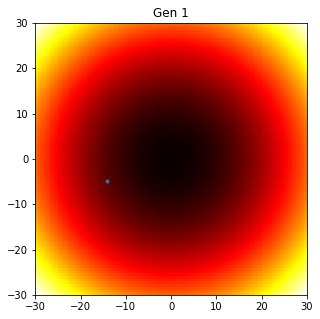

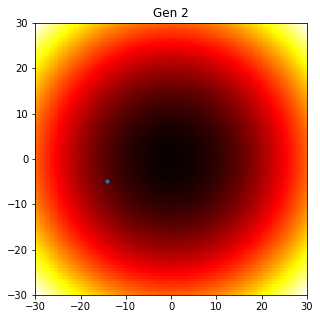

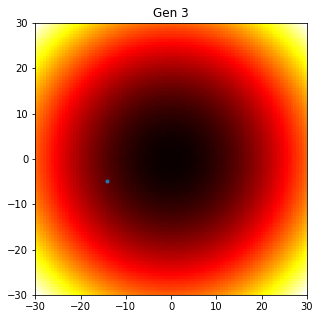

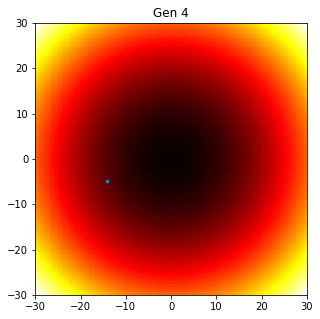

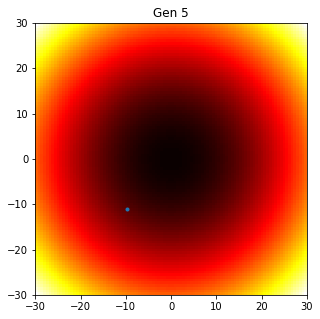

...

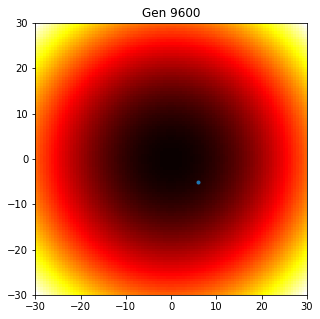

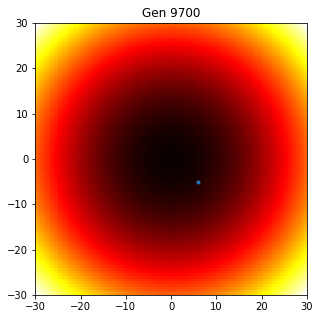

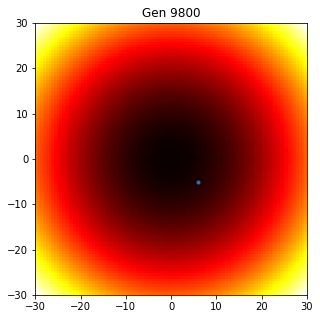

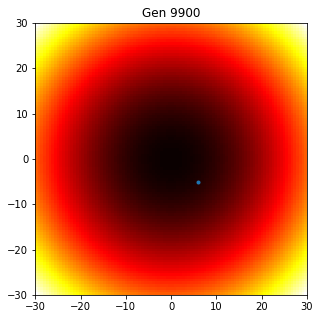

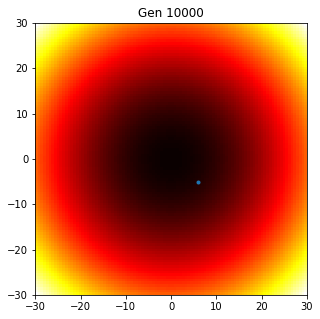

Best fit 572.0505871954888 at iteration 4545
Terminé.


In [9]:
importlib.reload(myRandom)

myRandom.launch_random([20]*16,ma_func=myEvalFn.sphere)

print ("Terminé.")

Parent :  [20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20]


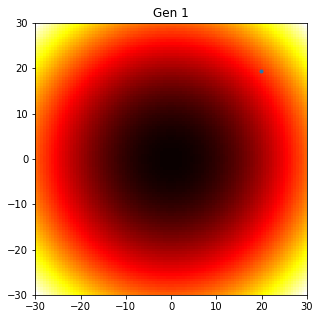

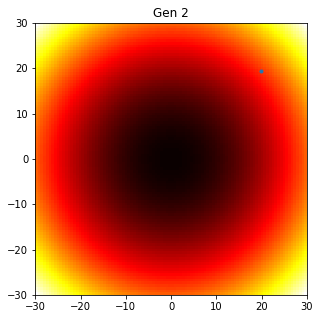

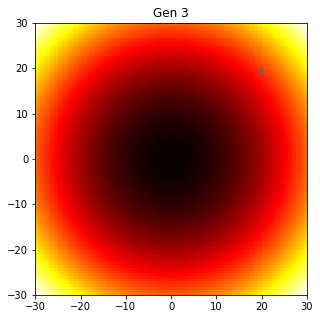

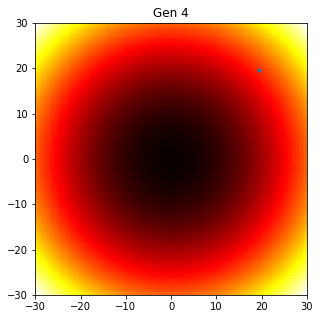

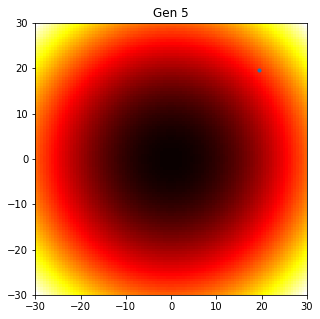

...

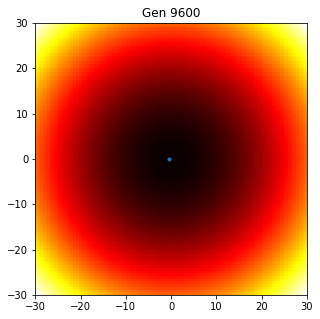

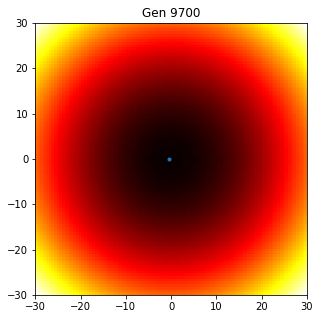

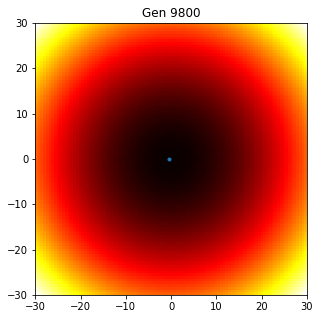

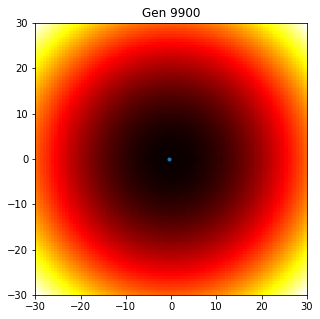

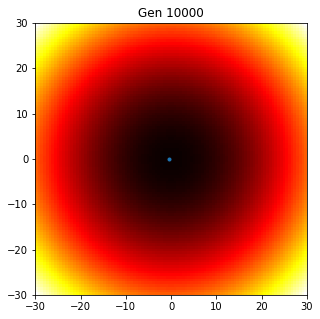

Best fit 1.0755061247797393 at iteration 5509
Terminé.


In [10]:
importlib.reload(myES)

def launch_oneplusone(center, sigma, nbeval=10000, display=True, ma_func=myEvalFn.sphere):
    parent = np.array(center)
    i=0
    j=0
    parentFit = ma_func(parent)
    bestFit = parentFit
    bestIt = 0
    print("Parent : ", parent)
    while i<nbeval:

        child = parent + sigma*np.random.normal(0,np.ones(parent.shape),parent.shape)
        childFit = ma_func(child)
        if childFit <= parentFit:
            parentFit = childFit
            parent = np.copy(child)
            if bestFit > parentFit:
                bestFit = parentFit
                bestIt = i
        j+=1
        solutions = np.array([parent])
        if display and ((j<10) or (j%100==0)):
            plot_results(ma_func,solutions, title="Gen %d"%(j))
        i+=1
    print ("Best fit",bestFit,"at iteration",bestIt)
    return bestFit

launch_oneplusone([20]*16,0.5,ma_func=myEvalFn.sphere)

print ("Terminé.")

Parent :  [20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20]


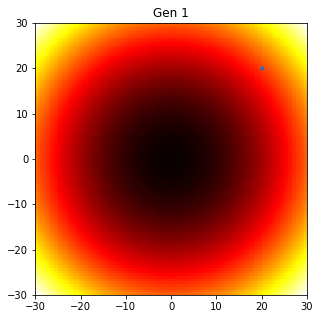

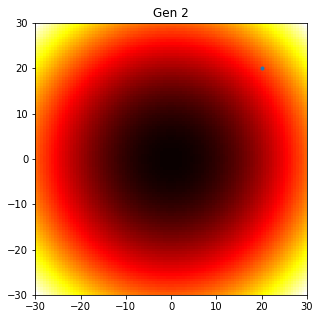

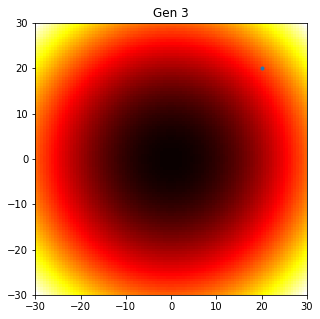

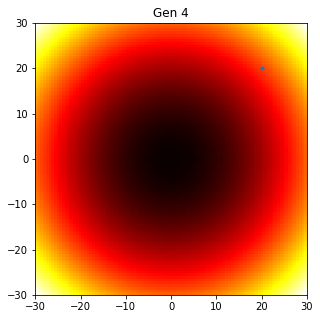

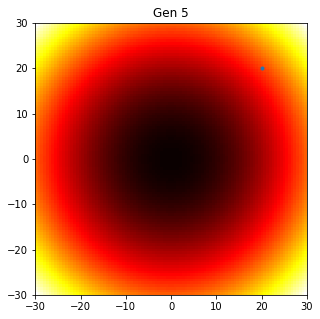

...

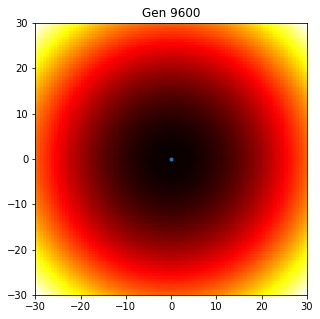

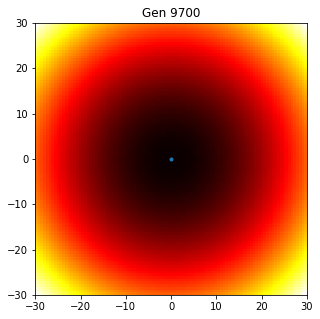

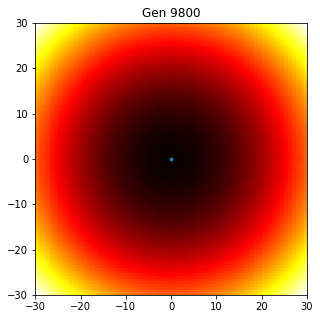

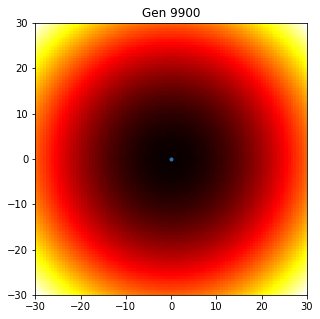

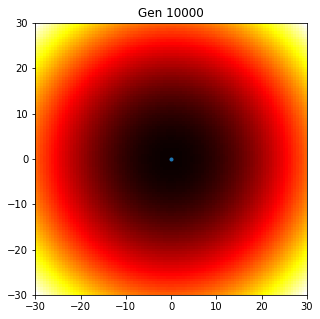

Best fit 1.5213277955051183e-79 at iteration 9998
Terminé.


In [12]:
importlib.reload(myES)
def launch_ESonefifthRule(center, sigma, nbeval=10000, display=True, ma_func=myEvalFn.sphere):
    parent = np.array(center)
    i = 0
    j = 0
    parentFit = ma_func(parent)
    bestFit = parentFit
    bestIt = 0
    print("Parent : ", parent)
    while i < nbeval:

        child = parent + sigma * np.random.normal(0, np.ones(parent.shape), parent.shape)
        childFit = ma_func(child)
        if childFit <= parentFit:
            parentFit = childFit
            parent = np.copy(child)
            sigma = sigma*2
            if bestFit > parentFit:
                bestFit = parentFit
                bestIt = i
        else:
            sigma = sigma*(2**(-(1/4)))
        j += 1
        solutions = np.array([parent])
        if display and ((j < 10) or (j % 100 == 0)):
            plot_results(ma_func, solutions, title="Gen %d" % (j))
        i += 1
    print("Best fit", bestFit, "at iteration", bestIt)
    return bestFit

launch_ESonefifthRule([20]*16,50,ma_func=myEvalFn.sphere)

print ("Terminé.")

Parent :  [17.07638506 27.92372264 16.27593796 34.23260242 28.05097014 23.90054716
 17.97858605 26.57795911 25.20396455 11.95275853 16.08099324  8.94671176
 16.67405793 26.53988409 17.51076979  8.1874532 ]


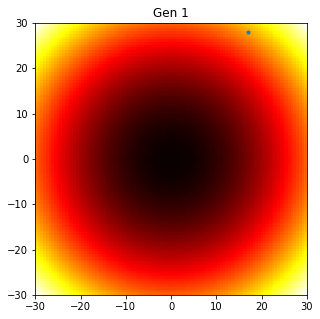

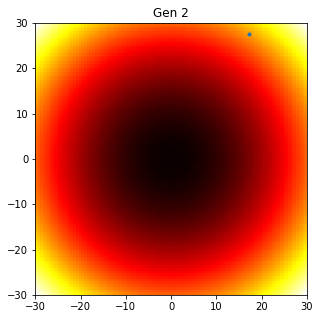

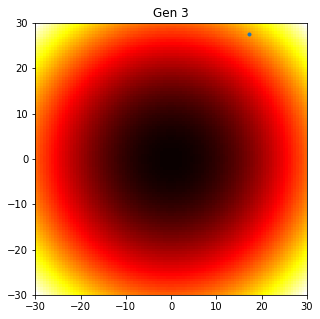

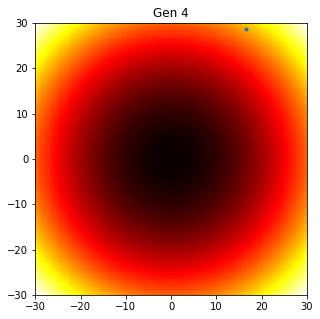

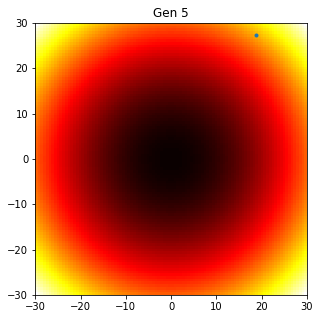

...

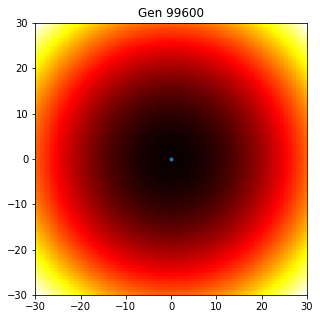

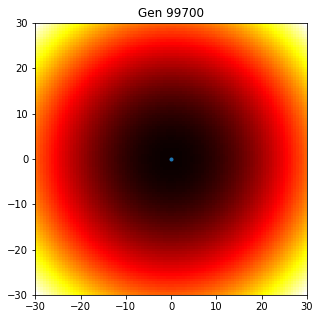

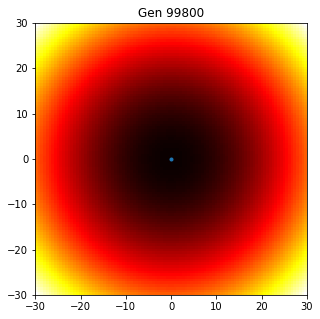

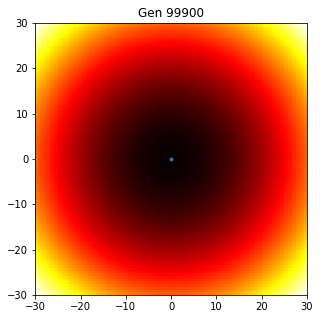

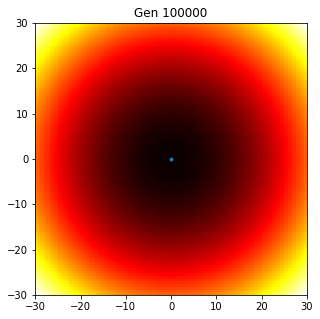

Best fit 0.0 at iteration 3826
Terminé.


In [13]:
importlib.reload(myES)


def launch_LambdaES(center, _lambda, sigma, nbeval=10000, display=True, ma_func=myEvalFn.sphere):
    center = np.array(center)
    parent = center + sigma * np.random.normal(0, center.shape, center.shape[0])
    i = 0
    j = 0
    parentFit = ma_func(parent)
    bestFit = parentFit
    bestIt = 0
    print("Parent : ", parent)
    while i < nbeval:
        for k in range(_lambda):
            child = parent + sigma * np.random.normal(0, np.ones(parent.shape), parent.shape)
            childFit = ma_func(child)
            if childFit <= parentFit:
                parentFit = childFit
                parent = np.copy(child)
                sigma = sigma * 2
                if bestFit > parentFit:
                    bestFit = parentFit
                    bestIt = i
            else:
                sigma = sigma * (2 ** (-(1 / 4)))
            j += 1
            solutions = np.array([parent])
            if display and ((j < 10) or (j % 100 == 0)):
                plot_results(ma_func, solutions, title="Gen %d" % (j))
        i += 1
    print("Best fit", bestFit, "at iteration", bestIt)
    return bestFit


_lambda = 10
launch_LambdaES([20]*16,_lambda,0.5,ma_func=myEvalFn.sphere)

print ("Terminé.")

# Prototypage d'algortihmes évolutionnaires avec DEAP 

Dans cette partie on va utiliser deap, un outil permettant le prototypage rapide et facile d'algorithmes évolutionnaires 